<a href="https://colab.research.google.com/github/oreade16/EEG_GAN/blob/main/CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data Preprocessing

In [ ]:
import numpy as np
import torch
import pandas as pd
import torch.nn as nn

In [ ]:
fake_data = np.load("./josh_output.npy")
real_data = np.load("real.npy")


In [ ]:
real_data_labels = np.ones(60)
fake_data_labels = np.zeros(60)

In [ ]:
df1 = pd.DataFrame(columns=["EEG","output"],)
df1


,EEG,output


In [ ]:
for i in range(60):
    df1.loc[i]=[np.ndarray.tolist(real_data[i]),real_data_labels[i]]

In [ ]:
for i in range(60):
    df1.loc[i+60]=[np.ndarray.tolist(fake_data[i]),fake_data_labels[i]]


In [ ]:
import torch
for i in df1.index:
    df1['EEG'][i]=torch.FloatTensor(df1['EEG'][i])
df1

/var/folders/jv/b184fmt91335d1wjzyr9185h0000gn/T/ipykernel_30542/2664651767.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['EEG'][i]=torch.FloatTensor(df1['EEG'][i])


,EEG,output
0,"[[tensor(1.0324), tensor(1.0325), tensor(1.032...",1.0
1,"[[tensor(0.9200), tensor(0.9212), tensor(0.922...",1.0
2,"[[tensor(0.8091), tensor(0.8079), tensor(0.806...",1.0
3,"[[tensor(0.6692), tensor(0.6746), tensor(0.679...",1.0
4,"[[tensor(1.2288), tensor(1.2195), tensor(1.210...",1.0
...,...,...
115,"[[tensor(0.4972), tensor(0.4923), tensor(0.591...",0.0
116,"[[tensor(0.3416), tensor(0.6281), tensor(0.705...",0.0
117,"[[tensor(0.5439), tensor(0.6114), tensor(0.593...",0.0
118,"[[tensor(0.2454), tensor(0.6473), tensor(0.723...",0.0


In [ ]:
df1


,EEG,output
0,"[[tensor(1.0324), tensor(1.0325), tensor(1.032...",1.0
1,"[[tensor(0.9200), tensor(0.9212), tensor(0.922...",1.0
2,"[[tensor(0.8091), tensor(0.8079), tensor(0.806...",1.0
3,"[[tensor(0.6692), tensor(0.6746), tensor(0.679...",1.0
4,"[[tensor(1.2288), tensor(1.2195), tensor(1.210...",1.0
...,...,...
115,"[[tensor(0.4972), tensor(0.4923), tensor(0.591...",0.0
116,"[[tensor(0.3416), tensor(0.6281), tensor(0.705...",0.0
117,"[[tensor(0.5439), tensor(0.6114), tensor(0.593...",0.0
118,"[[tensor(0.2454), tensor(0.6473), tensor(0.723...",0.0


In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X = df1.iloc[:,0]

y = df1.iloc[:,1]



In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
X_train,y_train

(42     [[tensor(1.5872), tensor(1.5785), tensor(1.568...
 12     [[tensor(2.4208), tensor(2.4153), tensor(2.409...
 15     [[tensor(0.5419), tensor(0.5396), tensor(0.537...
 114    [[tensor(1.6642), tensor(1.6295), tensor(1.379...
 76     [[tensor(3.6932), tensor(3.3424), tensor(3.336...
                              ...                        
 106    [[tensor(0.6706), tensor(0.6695), tensor(0.639...
 14     [[tensor(0.3555), tensor(0.3670), tensor(0.379...
 92     [[tensor(1.4819), tensor(1.4194), tensor(1.428...
 51     [[tensor(1.9268), tensor(1.9434), tensor(1.959...
 102    [[tensor(0.8746), tensor(1.0086), tensor(0.967...
 Name: EEG, Length: 96, dtype: object,
 42     1.0
 12     1.0
 15     1.0
 114    0.0
 76     0.0
       ... 
 106    0.0
 14     1.0
 92     0.0
 51     1.0
 102    0.0
 Name: output, Length: 96, dtype: float64)

In [ ]:
class Dense_CNN(nn.Module):
    def __init__(self, ):
        super().__init__()

        self.linear_1 = nn.Linear(3000,1500)
        self.linear_2 = nn.Linear(1500,300)
        self.linear_3 = nn.Linear(300,1)
        self.Sigmoid = nn.Sigmoid()

    def forward(self,x):
        x = self.linear_1(x)
        x = self.linear_2(x)
        x = self.linear_3(x)
        x = self.Sigmoid(x)
        return x



In [ ]:
class Linear_CNN(nn.Module):


    def __init__(self, ):
        super().__init__()

        self.conv1 = nn.Conv1d(in_channels=1,out_channels=1,kernel_size=9,stride=2,padding=4)
        self.fc1 = nn.Linear(1500,1)
        self.sigmoid = nn.Sigmoid()
        self.relu = nn.ELU()



    def forward(self,x):
        x = x.reshape(x.shape[0],1,3000)
        x = self.relu(self.conv1(x))
        x = self.fc1(x)
        x = x.reshape(x.shape[0],-1)
        x = self.sigmoid(x)




        return x

This is where the convolutional layers are used. I went from 3000 to 2 while keeping the number of channels the same.

In [ ]:
cnn = Linear_CNN()



In [ ]:
X_train=np.vstack(X_train).astype(np.float)
X_test=np.vstack(X_test).astype(np.float)
y_train=np.vstack(y_train).astype(np.float)
y_test =np.vstack(y_test).astype(np.float)

/var/folders/jv/b184fmt91335d1wjzyr9185h0000gn/T/ipykernel_30542/2855117469.py:1: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  X_train=np.vstack(X_train).astype(np.float)
/var/folders/jv/b184fmt91335d1wjzyr9185h0000gn/T/ipykernel_30542/2855117469.py:2: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  X_test=np.vstack(X_test).astype(np.float

In [ ]:
print(X_train.shape)

(96, 3000)


In [ ]:
X_train = torch.FloatTensor(X_train)
X_test = torch.FloatTensor(X_test)
y_train = torch.FloatTensor(y_train)
y_test = torch.FloatTensor(y_test)


In [ ]:
print(X_train.dtype)
cnn(X_train).shape

torch.float32


torch.Size([96, 1])

In [ ]:
import torch.optim as optim
optimizer = optim.SGD(cnn.parameters(), lr=0.01)
criterion = nn.BCELoss()
training_set = []
training_set = X_train,y_train
trainloader = torch.utils.data.DataLoader(training_set, batch_size=8, shuffle=True)
print(training_set)


(tensor([[ 1.5872,  1.5785,  1.5686,  ...,  1.0180,  1.0072,  0.9962],
        [ 2.4208,  2.4153,  2.4090,  ...,  3.0232,  3.0531,  3.0812],
        [ 0.5419,  0.5396,  0.5374,  ...,  0.7395,  0.7369,  0.7342],
        ...,
        [ 1.4819,  1.4194,  1.4286,  ...,  0.2715,  0.2833,  0.5228],
        [ 1.9268,  1.9434,  1.9598,  ...,  0.7960,  0.7790,  0.7621],
        [ 0.8746,  1.0086,  0.9679,  ..., -0.0037, -0.2424, -0.0491]]), tensor([[1.],
        [1.],
        [1.],
        [0.],
        [0.],
        [0.],
        [1.],
        [0.],
        [1.],
        [0.],
        [1.],
        [0.],
        [1.],
        [1.],
        [0.],
        [1.],
        [1.],
        [1.],
        [0.],
        [1.],
        [0.],
        [0.],
        [1.],
        [0.],
        [0.],
        [1.],
        [1.],
        [1.],
        [1.],
        [0.],
        [1.],
        [0.],
        [1.],
        [1.],
        [0.],
        [0.],
        [0.],
        [1.],
        [1.],
        [0.],
    

In [ ]:
running_loss = []
for epochs in range(1000):

    optimizer.zero_grad()
        # forward + backward + optimize

    outputs = cnn(X_train)
    print(outputs,y_train)
    loss = criterion(outputs, y_train)
    print(criterion(outputs,y_train))
    loss.backward()
    optimizer.step()
    print(loss.item())

        # print statistics
    running_loss.append(loss.item())
    print(running_loss)




tensor([[0.9878],
        [0.9035],
        [0.9472],
        [0.0084],
        [0.0086],
        [0.0013],
        [0.9883],
        [0.0061],
        [0.9117],
        [0.0073],
        [0.9730],
        [0.0013],
        [0.9818],
        [0.9281],
        [0.0565],
        [0.9898],
        [0.9860],
        [0.9778],
        [0.0081],
        [0.9822],
        [0.0400],
        [0.0024],
        [0.9848],
        [0.0094],
        [0.0973],
        [0.9732],
        [0.9128],
        [0.8773],
        [0.8906],
        [0.0014],
        [0.9561],
        [0.0043],
        [0.9920],
        [0.9820],
        [0.0264],
        [0.0602],
        [0.0371],
        [0.9547],
        [0.9362],
        [0.0315],
        [0.0065],
        [0.9314],
        [0.9603],
        [0.0189],
        [0.7735],
        [0.9808],
        [0.9753],
        [0.0088],
        [0.9824],
        [0.0038],
        [0.0052],
        [0.0996],
        [0.9448],
        [0.9768],
        [0.1637],
        [0

KeyboardInterrupt: 

In [ ]:
cnn.eval()
print(running_loss)

[0.7026059031486511, 0.6885783076286316, 0.6836133003234863, 0.6788585782051086, 0.6742584109306335, 0.6698033809661865, 0.6654844284057617, 0.6612935066223145, 0.6572225689888, 0.6532644629478455, 0.6494119763374329, 0.6456589102745056, 0.6419991850852966, 0.6384270787239075, 0.6349373459815979, 0.6315250992774963, 0.6281856894493103, 0.624914824962616, 0.6217084527015686, 0.6185628771781921, 0.6154745221138, 0.612440288066864, 0.6094570159912109, 0.6065218448638916, 0.6036320924758911, 0.6007853150367737, 0.5979792475700378, 0.5952116250991821, 0.592480480670929, 0.5897838473320007, 0.587119996547699, 0.58448725938797, 0.5818840861320496, 0.5793089866638184, 0.5767605900764465, 0.5742376446723938, 0.5717388987541199, 0.5692632794380188, 0.5668096542358398, 0.5643770694732666, 0.5619645714759827, 0.5595713257789612, 0.5571964383125305, 0.5548391342163086, 0.5524986386299133, 0.5501744151115417, 0.5478656888008118, 0.5455718636512756, 0.5432923436164856, 0.5410266518592834, 0.538774251

In [ ]:
outputs = cnn(X_test)
outputs = torch.round(outputs)
outputs

accuracy = torch.sum(outputs==y_test)
print("The accuracy is ", accuracy.item()/outputs.shape[0]*100 ,"%")


        # The output of the model are log-probabilities, we need to exponentiate them to get probabilities


The accuracy is  91.66666666666666 %


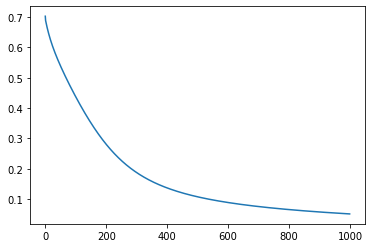

In [ ]:
import matplotlib.pyplot as plt
plt.plot(torch.arange(1000),torch.FloatTensor(running_loss))

I then decided to use the dense layers

In [ ]:
cnn = Dense_CNN()

In [ ]:
import torch.optim as optim
optimizer = optim.SGD(cnn.parameters(), lr=0.01)
criterion = nn.BCELoss()
training_set = []
training_set = X_train,y_train
trainloader = torch.utils.data.DataLoader(training_set, batch_size=8, shuffle=True)
print(training_set)

(tensor([[ 1.5872,  1.5785,  1.5686,  ...,  1.0180,  1.0072,  0.9962],
        [ 2.4208,  2.4153,  2.4090,  ...,  3.0232,  3.0531,  3.0812],
        [ 0.5419,  0.5396,  0.5374,  ...,  0.7395,  0.7369,  0.7342],
        ...,
        [ 1.4819,  1.4194,  1.4286,  ...,  0.2715,  0.2833,  0.5228],
        [ 1.9268,  1.9434,  1.9598,  ...,  0.7960,  0.7790,  0.7621],
        [ 0.8746,  1.0086,  0.9679,  ..., -0.0037, -0.2424, -0.0491]]), tensor([[1.],
        [1.],
        [1.],
        [0.],
        [0.],
        [0.],
        [1.],
        [0.],
        [1.],
        [0.],
        [1.],
        [0.],
        [1.],
        [1.],
        [0.],
        [1.],
        [1.],
        [1.],
        [0.],
        [1.],
        [0.],
        [0.],
        [1.],
        [0.],
        [0.],
        [1.],
        [1.],
        [1.],
        [1.],
        [0.],
        [1.],
        [0.],
        [1.],
        [1.],
        [0.],
        [0.],
        [0.],
        [1.],
        [1.],
        [0.],
    

In [ ]:
running_loss = []
for epochs in range(1000):



    optimizer.zero_grad()
        # forward + backward + optimize

    outputs = cnn(X_train)
    print(outputs,y_train)
    loss = criterion(outputs, y_train)
    print(criterion(outputs,y_train))
    loss.backward()
    optimizer.step()
    print(loss.item())

        # print statistics
    running_loss.append(loss.item())
    print(running_loss)

tensor([[0.5099],
        [0.4893],
        [0.4966],
        [0.4579],
        [0.4656],
        [0.4814],
        [0.5270],
        [0.4562],
        [0.4977],
        [0.4586],
        [0.5055],
        [0.4752],
        [0.4692],
        [0.4802],
        [0.4963],
        [0.4597],
        [0.4932],
        [0.4784],
        [0.4942],
        [0.4963],
        [0.5109],
        [0.4501],
        [0.4216],
        [0.5200],
        [0.4889],
        [0.4774],
        [0.5144],
        [0.4829],
        [0.4668],
        [0.5038],
        [0.5222],
        [0.4609],
        [0.4915],
        [0.5163],
        [0.4751],
        [0.5091],
        [0.4709],
        [0.4879],
        [0.4590],
        [0.4916],
        [0.5077],
        [0.4714],
        [0.5052],
        [0.4908],
        [0.4836],
        [0.4667],
        [0.4807],
        [0.5134],
        [0.5076],
        [0.4716],
        [0.4860],
        [0.4955],
        [0.5045],
        [0.4920],
        [0.4938],
        [0

In [ ]:
outputs = cnn(X_test)
outputs = torch.round(outputs)
outputs

accuracy = torch.sum(outputs==y_test)
print("The accuracy is ", accuracy.item()/outputs.shape[0]*100 ,"%")


The accuracy is  95.83333333333334 %


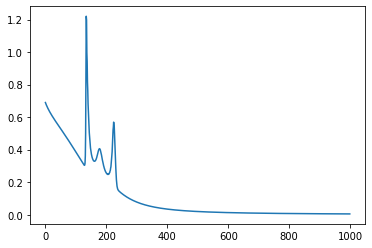

In [ ]:
import matplotlib.pyplot as plt
plt.plot(torch.arange(1000),torch.FloatTensor(running_loss))

In [ ]:
torch.save(cnn,'convnet.pt')

In [ ]:
hand_data = torch.load("hand.pt")
tongue_data =torch.load("tongue.pt")


In [ ]:
hand_data_labels = torch.ones(30)
tongue_data_labels = torch.zeros(30)

In [ ]:
df1 = pd.DataFrame(columns=["EEG","output"],)
df1

,EEG,output


In [ ]:
print(tongue_data[0])


tensor([[0.6692, 0.6746, 0.6798,  ..., 0.5492, 0.5446, 0.5400],
        [1.2471, 1.2669, 1.2881,  ..., 0.4570, 0.4604, 0.4643],
        [1.0215, 1.0133, 1.0049,  ..., 0.8660, 0.8542, 0.8429],
        ...,
        [0.8965, 0.8860, 0.8755,  ..., 1.2361, 1.2527, 1.2689],
        [0.5335, 0.5315, 0.5296,  ..., 0.7759, 0.7878, 0.7994],
        [1.4393, 1.4498, 1.4594,  ..., 1.1296, 1.1478, 1.1657]])


In [ ]:
data = torch.cat((tongue_data,hand_data))
labels = torch.cat((tongue_data_labels,hand_data_labels))

In [ ]:
class CNN_tongueorhand(nn.Module):
    def __init__(self ):
        super().__init__()

        self.conv_init = nn.Conv1d(in_channels=46,out_channels=1,kernel_size=9,padding=4)
        self.conv_1 = nn.Conv1d(in_channels=23,out_channels=11,kernel_size=9,padding=4)
        self.conv_2 = nn.Conv1d(in_channels=11,out_channels=5,kernel_size=9,padding=4)
        self.conv_3 = nn.Conv1d(in_channels=5,out_channels=2,kernel_size=9,padding=4)
        self.conv_4 = nn.Conv1d(in_channels=2,out_channels=1,kernel_size=9,padding=4)
        self.sigmoid = nn.Sigmoid()
        self.dropout = nn.Dropout(0.25)
        self.dense = nn.Linear(3000,1)
        self.relu = nn.ReLU()


    def forward(self,x):
        x = x.reshape(x.shape[0],46,3000)
        x =self.relu(self.conv_init(x))

        x = self.dense(x)
        x = self.sigmoid(x)
        x = x.reshape(x.shape[0],-1)




        return x

In [ ]:
tongue_or_hand = CNN_tongueorhand()

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)


In [ ]:
optimizer = optim.SGD(tongue_or_hand.parameters(), lr=0.01)

criterion = nn.BCELoss()

In [ ]:
running_loss = []
for epochs in range(1000):



    optimizer.zero_grad()
        # forward + backward + optimize

    print(X_train.shape)
    outputs = tongue_or_hand(X_train)
    y_train = y_train.reshape(48,1)
    print(outputs,y_train)
    loss = criterion(outputs, y_train)
    print(criterion(outputs,y_train))
    loss.backward()
    optimizer.step()
    print(loss.item())

        # print statistics
    running_loss.append(loss.item())
    print(running_loss)

torch.Size([48, 46, 3000])
tensor([[0.5005],
        [0.5005],
        [0.5003],
        [0.5007],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5002],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5004],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5016],
        [0.5005],
        [0.5005],
        [0.5004],
        [0.5001],
        [0.5005],
        [0.5029],
        [0.5005],
        [0.5003],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5005],
        [0.5016],
        [0.5005],
        [0.5152],
        [0.5005],
        [0.4998],
        [0.5042],
        [0.5005],
        [0.4996],
        [0.4998],
        [0.5005],
        [0.4973],
        [0.5005]], grad_fn=<ReshapeAliasBackward0>) tensor([[1.],
        [0.],
        [1.],
        [0.],
        [0.],
     

In [ ]:
outputs = tongue_or_hand(X_test)

outputs = torch.round(outputs)
outputs

accuracy = torch.sum(outputs==y_test.reshape(12,1))
print("The accuracy is ", accuracy.item()/outputs.shape[0]*100 ,"%")


The accuracy is  100.0 %


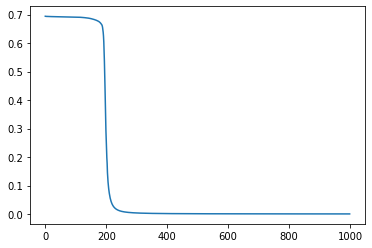

In [ ]:
import matplotlib.pyplot as plt
plt.plot(torch.arange(1000),torch.FloatTensor(running_loss))